#  How do we deploy the Chicago police force to efficiently fight crime?

In [3]:
pip install branca

Note: you may need to restart the kernel to use updated packages.


In [11]:
pip install wordcloud

Note: you may need to restart the kernel to use updated packages.


In [3]:
import pandas              as pd # The gold standard of Python data analysis, to create and manipulate tables of data
import numpy               as np # The Python module for processing arrays which/Pandas is based on
import matplotlib.pyplot   as plt # The gold standard of Python data visualization, but can be complex to use
import seaborn             as sns; sns.set() # A package to make Matplotlib visualizations more aesthetic
import branca
import geopandas

import folium # package for making maps, please make sure to use a version older than 1.0.0.
from wordcloud import WordCloud # A package that will allow us to make a wordcloud
from scipy.stats import ttest_ind # A module for Python machine learning--we'll stick to T-Tests here
from IPython.display import display
from folium.plugins import TimeSliderChoropleth
# from time_slider_choropleth import TimeSliderChoropleth
%matplotlib inline
plt.rcParams["figure.figsize"] = (8,5)

_"I think that's how Chicago got started. A bunch of people in New York said, 'Gee, I'm enjoying the crime and the poverty, but it just isn't cold enough. Let's go west."_ - Richard Jeni

_"Chicago is known for good steaks, expensive stores, and beautiful architecture. Unfortunately, the Windy City also enjoys a reputation for corrupt politics [and] violent crime."_ - Bob Barr

## Goals

Exploratory data analysis is one of the most important portions of data science. This case builds upon Case 4.3 to encourage further practice with a focus on technical implementation. We hope after this case students are able to think critically and ask logical questions, as well as have the technical capability to investigate those questions. Technical capabilities in this case mainly refers to utilizing data visualizations, manipulating DataFrames in `pandas` and creating custom Python functions to quantify metrics.

## Introduction

**Business Context.** Congratulations! You were recently promoted to regional Chief of Strategy of the Chicago Police Department. You have many years of experience with field work, but this is your first time having to think about the bigger picture. Chicago is a large city, and your resources are limited. Thus you need to devise a comprehensive plan to enhance the efficiency of police force deployment to fight crime. Making data-driven decisions is essential, even in law enforcement where prior knowledge usually dominates the decision-making process.

**Business Problem.** Your main task is to **explore the data and identify patterns of crime in Chicago, and come up with strategies to efficiently deploy your workforce to fight crime.** 

**Analytical Context.** So, you found a dataset available to the Chicago PD from 2017 with information on crimes committed throughout the city. In this case, we will focus on exploratory analysis to construct some preliminary strategies for police deployment. These strategies can be further consolidated or dismissed using more rigorous statistical analysis. One of the key aspects of this case is that our data contains records of crime incidents where often we do not have a clear definition of outcome (such as "severity" of a crime). We will discuss ways of dealing with such data, and how they can be incorporated to have meaningful conclusions. 

The case is structured as follows. We will (1) look at univariate summaries (2) come up with a preliminary strategy based on this (3) look at joint distributions and revise our strategy, and finally (4) think about changing strategies depending on our priorities and severity of the crimes.

## Exploring patterns associated with individual variables of interest

Let's read in and view our dataset. This dataset is downloaded from this [website](https://data.cityofchicago.org/Public-Safety/Crimes-2017/d62x-nvdr). It contains reported crime incidents (with the exception of murders, where data exists for each victim) that occured in the City of Chicago in 2017.

We began Case 4.3 with a basic exploration of the distribution of the various parameters. Since this dataset is more focused on categorical data, we will start by investigating the various frequencies of each category within each parameter:

In [5]:
df = pd.read_csv('Chicago_crime_data.csv', dtype={'ID': object, 'beat_num': object})
df

,ID,Case Number,Date,Block,IUCR,Primary Type,Description,Location Description,Arrest,Domestic,...,Ward,Community Area,FBI Code,X Coordinate,Y Coordinate,Year,Updated On,Latitude,Longitude,Location
0,11192233,JB100016,12/31/17 23:58,046XX N ST LOUIS AVE,630,BURGLARY,ATTEMPT FORCIBLE ENTRY,APARTMENT,False,False,...,33.0,14,5,1152214.0,1930694.0,2017,5/4/18 15:51,41.965694,-87.715726,"(41.965693651, -87.715726125)"
1,11196379,JB105867,12/31/17 23:50,024XX N LAKE SHORE DR NB,460,BATTERY,SIMPLE,MOVIE HOUSE/THEATER,False,False,...,43.0,7,08B,1175293.0,1916610.0,2017,5/4/18 15:51,41.926559,-87.631294,"(41.926558908, -87.631294073)"
2,11192540,JB100551,12/31/17 23:48,001XX E SUPERIOR ST,890,THEFT,FROM BUILDING,HOTEL/MOTEL,False,False,...,42.0,8,6,1177508.0,1905401.0,2017,5/4/18 15:51,41.895751,-87.623496,"(41.895750913, -87.623495923)"
3,11192239,JB100032,12/31/17 23:45,019XX S CANAL ST,1320,CRIMINAL DAMAGE,TO VEHICLE,STREET,False,True,...,25.0,31,14,1173432.0,1891037.0,2017,5/4/18 15:51,41.856427,-87.638893,"(41.856426716, -87.638892854)"
4,11192254,JB100003,12/31/17 23:45,115XX S STATE ST,041A,BATTERY,AGGRAVATED: HANDGUN,RESIDENCE,False,True,...,34.0,53,04B,1178329.0,1828012.0,2017,5/4/18 15:51,41.683369,-87.622830,"(41.683369303, -87.622829524)"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
268298,11035993,JA367627,1/1/17 0:00,026XX W COYLE AVE,1752,OFFENSE INVOLVING CHILDREN,AGG CRIM SEX ABUSE FAM MEMBER,RESIDENCE,False,False,...,50.0,2,20,1157570.0,1946019.0,2017,2/10/18 15:50,42.007638,-87.695614,"(42.007638503, -87.695613598)"
268299,10942975,JA261045,1/1/17 0:00,035XX S GILES AVE,281,CRIM SEXUAL ASSAULT,NON-AGGRAVATED,"SCHOOL, PUBLIC, BUILDING",True,False,...,2.0,35,2,1178842.0,1881615.0,2017,2/10/18 15:50,41.830450,-87.619323,"(41.830450306, -87.61932306)"
268300,10942796,JA260938,1/1/17 0:00,028XX N WESTERN AVE,1330,CRIMINAL TRESPASS,TO LAND,OTHER,False,False,...,1.0,21,26,1159863.0,1918955.0,2017,2/10/18 15:50,41.933326,-87.687927,"(41.933326413, -87.687927299)"
268301,10801141,JA100083,1/1/17 0:00,011XX W DICKENS AVE,486,BATTERY,DOMESTIC BATTERY SIMPLE,APARTMENT,False,True,...,43.0,7,08B,1168452.0,1914119.0,2017,2/14/17 15:49,41.919874,-87.656504,"(41.919874416, -87.656503702)"


We can see above that the table contains 22 columns and there are 268,303 records in total. Since each homicide case could have more than one row, the actual number of cases is smaller than 268,303. Blow is a brief description of each column:

|     Variable name    |                    Variable description                    |                                                                                                  Note                                                                                                  |
|:--------------------:|:----------------------------------------------------------:|:------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------:|
|          ID          |              Unique identifier for the record              |                                                                   Each victim in a single homicide case is assigned to a different ID                                                                  |
|      Case Number     | The Chicago Police Department RD (Records Division) number |                                                  Unique to the incident. Multiple IDs can share the same Case Number if the incident is a homicide case                                                 |
|         Date         |               Date when the incident occurred              |                                                                                Might be a best estimate for some records                                                                               |
|         Block        | The partially redacted address where the incident occurred |                                                                    The redacted address is in the same block as the actual address                                                                    |
|         IUCR         |          The Illinois Uniform Crime Reporting code         |                                Directly linked to the primary type and the description of the crime. See details [here]( https://data.cityofchicago.org/widgets/c7ck-438e)                                |
|     Primary Type     |          The primary description of the IUCR code          |      -                                                                                                                                                                                                  |
|      Description     |         The secondary description of the IUCR code         |     -                                                                                                                                                                                                   |
| Location Description |   Description of the location where the incident occurred  |    -                                                                                                                                                                                                    |
|        Arrest        |                  Whether an arrest as made                 |     -                                                                                                                                                                                                   |
|       Domestic       |          Whether the incident was domestic-related         |                                                                Domestic-related definition is based on the Illinois Domestic Violence Act                                                               |
|       beat_num       |         The police beat where the incident occurred        |          Smallest police geographic area - each beat has a dedicated police beat car. See details [here](https://data.cityofchicago.org/Public-Safety/Boundaries-Police-Beats-current-/aerh-rz74)         |
|       District       |       The police district where the incident occurred      | Three to five beats make up a police sector and three sectors make up a police district. See details [here](https://data.cityofchicago.org/Public-Safety/Boundaries-Police-Districts-current-/fthy-xz3r) |
|         Ward         |            The ward where the incident occurred            |                          Wards are city council districts. See details [here](https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Wards-2015-/sp34-6z76)                          |
|    Community Area    |       The community area where the incident occurred       |                                     See details [here](https://data.cityofchicago.org/Facilities-Geographic-Boundaries/Boundaries-Community-Areas-current-/cauq-8yn6)                                    |
|       FBI Code       |   The crime classification as outlined in the FBI's NIBRS  |                         NIBRS stands for National Incident-Based Reporting System (NIBRS). See details [here]( http://gis.chicagopolice.org/clearmap_crime_sums/crime_types.html)                         |
|       Latitude       |  The latitude of the location where the incident occurred  |                                                   This location is shifted from the actual location for partial redaction but falls on the same block                                                  |
|       Longitude      |  The longitude of the location where the incident occurred |       -                                                                                                                                                                                                 |

There are quite a few factors, but most are either: (1) identifying information (e.g. `id`, `ICUR`); or (2) too granular to start with (e.g. `latitude`, `longitude`). Therefore, we will first focus on the following variables: `primary_type`, `description`, `location_description` (location types), `date` (time of occurrence) and `beat_num` (geographic location), which give valuable information without getting too granular too quickly. Our outcome of interest is the number of crime incidents.

## Investigating crimes by types and descriptions

Similar to the last EDA case, it makes sense to explore the relationship of `primary_type` and `description` with our outcome of interest, crime incidents. However, we cannot repeat the exact process where we look at the pairwise correlations between the variables of interest and the outcome. This is because both `primary_type` and `description` are categorical variables, so it would not make send to place them on a scatterplot and calculating correlations makes little sense.

Luckily, both variables are discrete so we can still count the total number of records which belong to a specific category for each of these two variables using a [**frequency table**](https://www.onlinemathlearning.com/frequency-tables.html). Note that `primary_type` and `description` are [**nested variables**](https://support.minitab.com/en-us/minitab/18/help-and-how-to/modeling-statistics/anova/supporting-topics/anova-models/what-are-crossed-and-nested-factors/), meaning each type of `primary_type` has its own set of descriptions that do not overlap. If two crimes have different `primary types` then they cannot have the same `description` by definition.

In [7]:
df["Primary Type"].value_counts()

Primary Type
THEFT                                64356
BATTERY                              49218
CRIMINAL DAMAGE                      29043
ASSAULT                              19304
DECEPTIVE PRACTICE                   19204
OTHER OFFENSE                        17235
BURGLARY                             13000
ROBBERY                              11879
NARCOTICS                            11659
MOTOR VEHICLE THEFT                  11385
CRIMINAL TRESPASS                     6815
WEAPONS VIOLATION                     4686
OFFENSE INVOLVING CHILDREN            2282
CRIM SEXUAL ASSAULT                   1631
PUBLIC PEACE VIOLATION                1498
INTERFERENCE WITH PUBLIC OFFICER      1087
SEX OFFENSE                           1031
PROSTITUTION                           735
HOMICIDE                               675
ARSON                                  444
GAMBLING                               191
LIQUOR LAW VIOLATION                   191
KIDNAPPING                             19

We can see the most prevalent primary type of crime is theft, followed by battery and criminal damage. More severe types, such as homicide, arson and human trafficking, are very rare. A more detailed description of crime types is listed in the `Description` column. We can further break down the above frequencies by `Description` since `Primary Type` and `Description` are nested variables. The resulting frequency table is shown below:

### Exercise 1:

Write code using the [groupby](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.groupby.html) function, to count the number of cases in all combinations of ``Primary Type`` and ``Description``. Then sort the results in decreasing order of the number of cases. Based on the results, what are most prevalent descriptions of theft, battery and criminal damage cases in Chicago?

**Answer.**

In [9]:

df.groupby(["Primary Type", "Description"])["ID"].count().reset_index(name="counts")\
.sort_values(by="counts", ascending = False).reset_index(drop=True).head(20)

,Primary Type,Description,counts
0,THEFT,$500 AND UNDER,24516
1,BATTERY,DOMESTIC BATTERY SIMPLE,23819
2,BATTERY,SIMPLE,16185
3,THEFT,OVER $500,15352
4,CRIMINAL DAMAGE,TO PROPERTY,13843
5,CRIMINAL DAMAGE,TO VEHICLE,13555
6,ASSAULT,SIMPLE,12743
7,THEFT,FROM BUILDING,10662
8,THEFT,RETAIL THEFT,10460
9,MOTOR VEHICLE THEFT,AUTOMOBILE,9834


There are in fact 310 descriptions in total and listing them all here is not viable. However, we can use a visualization tool known as a [**word cloud**](https://www.boostlabs.com/what-are-word-clouds-value-simple-visualizations/) to summarize the prevalent descriptions within each primary type. A word cloud visualizes the words within a collection of texts (in our case, the texts are all `Descriptions` for a specific primary type) and the size of each word is proportional to how often it appears in the datase. Below, we construct three word clouds for the top 3 most prevalent primary crime types:

In [11]:
# wordcloud for primary type defined by rank
def wordcloud_crime( df, rank ):
    df_filter = df[df["Primary Type"]==df["Primary Type"].value_counts().index[rank]]
    text = ' '.join(df_filter['Description'])
    wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(text)
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

Crime type:  THEFT


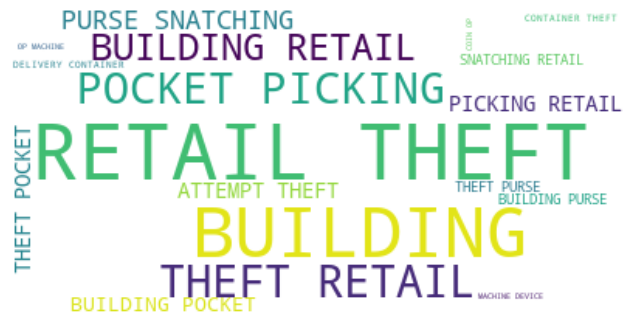

In [13]:
print("Crime type: ", df["Primary Type"].value_counts().index[0])
wordcloud_crime( df, 0 )

From the above wordcloud, it seems that the words "building" and "retail" are strongly linked to theft offenses, indicating that theft likely mainly happened indoors and in malls or retail stores.

### Exercise 2:

Use the code above to generate the wordcloud for battery cases and criminal damage cases. What are the most common words to describe these two types of cases?

**Answer.**

-------

In [15]:
def wordcloud_crime2( df, rank ):
    df_filter = df[df["Primary Type"]==df["Primary Type"].value_counts().index[rank]]
    text = ' '.join(df_filter['Description'])
    wordcloud = WordCloud(max_font_size=50, max_words=100, background_color="white").generate(text)
    plt.figure()
    plt.imshow(wordcloud, interpolation="bilinear")
    plt.axis("off")
    plt.show()

Crime type:  BATTERY


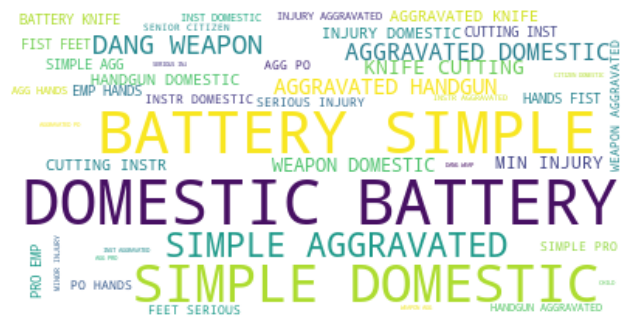

Crime type:  CRIMINAL DAMAGE


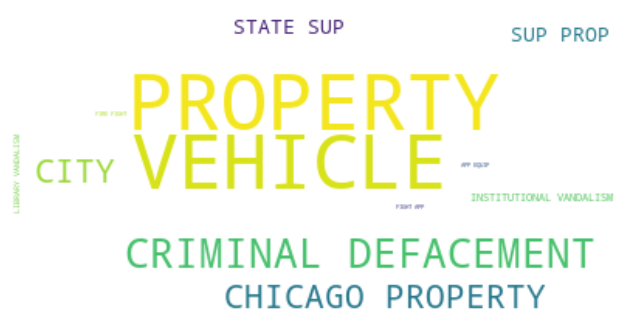

In [17]:
print("Crime type: ", df["Primary Type"].value_counts().index[1])
wordcloud_crime2( df, 1 )
print("Crime type: ", df["Primary Type"].value_counts().index[2])
wordcloud_crime2( df, 2 )

### Exercise 3:

As we have seen with word clouds, it seems that a given type of crime is usually linked with certain types of locations (e.g. at home, in retail stores). Write code to investigate the crime patterns associated with types of crime locations. Based on the results, which types of locations are more likely to have crime?

**Answer.**

-------

In [19]:
df["Location Description"].value_counts()

Location Description
STREET                     59975
RESIDENCE                  45880
APARTMENT                  33448
SIDEWALK                   21006
OTHER                      11327
                           ...  
CTA PROPERTY                   1
GAS STATION DRIVE/PROP.        1
RIVER BANK                     1
BASEMENT                       1
CLUB                           1
Name: count, Length: 128, dtype: int64

#### Contingency tables

So far, we have seen crime patterns linked with `Primary Type` and `Location Description` separately. It makes sense to see whether a certain combination of crime type and location type is prevalent or not. We know that both `Primary Type` and `Location Description` are discrete variables. We can therefore use a [**contingency table**](http://mathworld.wolfram.com/ContingencyTable.html) (cross table) to summarize the total number of incidents that belong to a specific combination of values of `Primary Type` and `Location Description`.

We cannot use the previous code where we analyzed `Primary Type` and `Description` together since unlike those two variables, `Location Description` and `Primary Type` are **NOT** nested variables. We can use the function `crosstab` in `pandas` to generate the contingency table of two variables.

### Exercise 4:

#### 4.1

`crosstab(var1, var2)` generates the contingency table for `var1` vs. `var2`. Use this function to generate a contingency table for `Primary Type` vs. `Location Description` where only the top 10 most prevalent crime locations and types are included.

**Answer.**

In [21]:
df_1 = df[df["Location Description"].isin(df["Location Description"].value_counts().index[:10]) & df["Primary Type"].isin(df["Primary Type"].value_counts().index[:10])]
pd.crosstab(df_1["Primary Type"],df_1["Location Description"])

Location Description,ALLEY,APARTMENT,OTHER,PARKING LOT/GARAGE(NON.RESID.),RESIDENCE,RESIDENTIAL YARD (FRONT/BACK),RESTAURANT,SIDEWALK,SMALL RETAIL STORE,STREET
Primary Type,,,,,,,,,,
ASSAULT,485,2839,753,499,3189,495,541,2189,363,3533
BATTERY,1038,11706,1021,849,10136,815,692,6812,321,6732
BURGLARY,18,3956,494,40,4170,29,312,6,319,49
CRIMINAL DAMAGE,434,3767,804,1442,5524,828,433,251,347,9997
DECEPTIVE PRACTICE,19,1762,2261,201,6225,20,925,226,601,965
MOTOR VEHICLE THEFT,196,70,277,861,307,299,15,29,9,8217
NARCOTICS,646,613,136,319,730,235,40,3264,28,3013
OTHER OFFENSE,158,2473,1355,158,6697,146,185,593,175,3451
ROBBERY,929,235,230,383,234,171,195,3513,366,3548


#### 4.2

Based on the contingency table above, what are the hot spots for the top 10 most prevalent types of crime? Are they the same or not?

**Answer.**

No, theft is markedly different from the others. Theft is spread widely across many locations, whereas the others are concentrated in a few spots.

#### 4.3

How can the above table help you deploy your workforce efficiently?

**Answer.**

This analysis is most useful when we want to identify hot spots for a specific type of crime. For instance, if the police department considers eliminating theft as a priority, then the above table can tell us where we should deploy more police forces to combat theft. The table gives us the following insights:

1. Other than theft, all major types of crime tend to concentrate in fewer than five types of locations, which indicates location-specific patrolling is more efficient for combatting those types of crime.
2. Theft offenses tend to be spread across all types of locations. It is the type of crime that would require more resources to control.

## Investigating crime by timestamp

We now move on to investigate the relationship between crime incidents and time; i.e. the `Date` variable we pointed out early on. Time is one of the most important dimensions for constructing an effective deployment plan. Since we cannot patrol every location 24/7, we must target periods of time with high crime rates. `Date` gives us a timestamp for each incident, which allows us to count how many incidents happened within a given period of time. Since we have one year's worth of data, we can start with monthly total incidents to see if certain months are crime-prone. 

We have covered a few cases dealing with temporal data and we generally group by different units of time (days, weeks, months) to discover different insights from the data. As we investigate from a temporal perspective, it is important to keep the concept of [confounding variables](https://www.statisticshowto.datasciencecentral.com/experimental-design/confounding-variable/) we introduced in Case 4.3 in our minds. An example would be discovering a pattern regarding June and July having more crime but the underlying factor is actually temperature. If Chicago had a particularly hot September in the future, a careful data scientist would expect more crimes rather than simply concluding that September always has fewer crimes than June/July.

### Exercise 5:



#### 5.1

Convert the column `Date` into datatime type and get the month for each record. Use the calculated `month` and `groupby` function and plot the total number of cases in each month.

**Answer.**

In [27]:
df["Date"].head()

0    12/31/17 23:58
1    12/31/17 23:50
2    12/31/17 23:48
3    12/31/17 23:45
4    12/31/17 23:45
Name: Date, dtype: object

In [23]:
df["date_py"] = pd.to_datetime(df.Date)

C:\Users\mauri\AppData\Local\Temp\ipykernel_5328\1152703864.py:1: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df["date_py"] = pd.to_datetime(df.Date)


In [29]:
df["date_py"] = pd.to_datetime(df["Date"], format="%m/%d/%y %H:%M")


In [31]:
# convert string to datatime type
df["date_py"] = pd.to_datetime(df.Date)

C:\Users\mauri\AppData\Local\Temp\ipykernel_5328\1912769427.py:2: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  df["date_py"] = pd.to_datetime(df.Date)


In [33]:
df["date_py"] = pd.to_datetime(df["Date"], format="%m/%d/%y %H:%M")

In [35]:
def plot_time( df, time_var, title, rot = 0):
    res = df.groupby([time_var])['ID'].count().reset_index(name="count")
    p = res.plot(x = time_var, y = "count", title = title, rot = rot)
    return p

In [37]:
df["month"] = df.date_py.dt.month
p_monthly = plot_time( df, "month", "2017-monthly crime patterns")
_ = plt.ylabel("Monthly total incidents")

In [39]:
df["year_month"] = df.date_py.dt.to_period("M")


In [51]:
%matplotlib inline


In [55]:
import matplotlib.pyplot as plt

def plot_time(df, time_var, title, rot=0):
    res = df.groupby([time_var])['ID'].count().reset_index(name="count")
    fig, ax = plt.subplots(figsize=(10, 5))  # Tamaño más amplio
    ax.plot(res[time_var].astype(str), res["count"], marker='o', linestyle='-')
    ax.set_title(title, fontsize=14)
    ax.set_xlabel(time_var, fontsize=12)
    ax.set_ylabel("Total incidents", fontsize=12)
    ax.tick_params(axis='x', rotation=rot)
    ax.grid(True, linestyle='--', alpha=0.5)
    plt.tight_layout()
    plt.show()  # Muy importante para mostrar el gráfico
    return ax


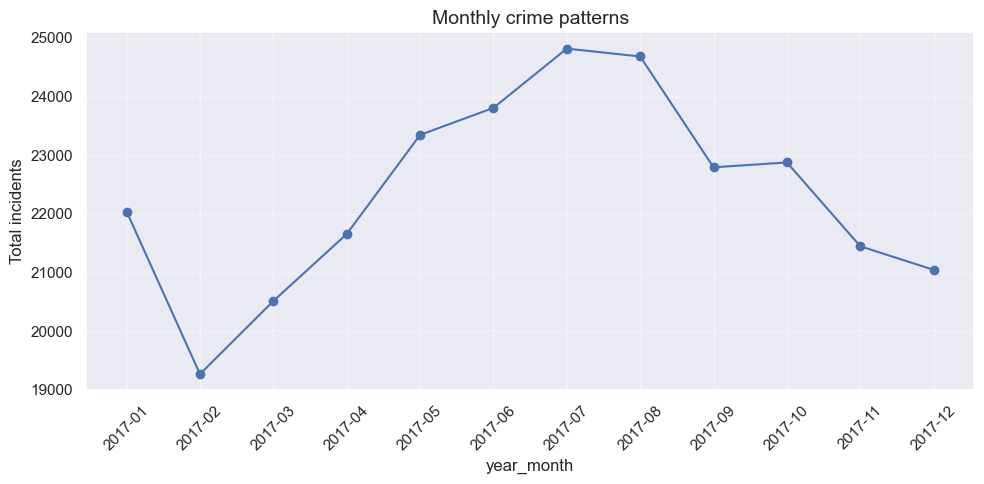

<Axes: title={'center': 'Monthly crime patterns'}, xlabel='year_month', ylabel='Total incidents'>

In [59]:
plot_time(df, "year_month", "Monthly crime patterns", rot=45)


#### 5.2

Which months have relatively higher crime rates? Why?

**Answer.**

Feburary has the lowest number of total incidents and crime incidents peak in July. Overall, more incidents occurred during the summer. This makes sense because Chicago is cold and windy in the winter, and neither perpetrators nor victims like to be out and about much then!

#### 5.3

Modify your code for monthly total incidents and instead plot the time series of daily total incidents throughout 2017. Do you still believe that February is the time when crime is least concerning?

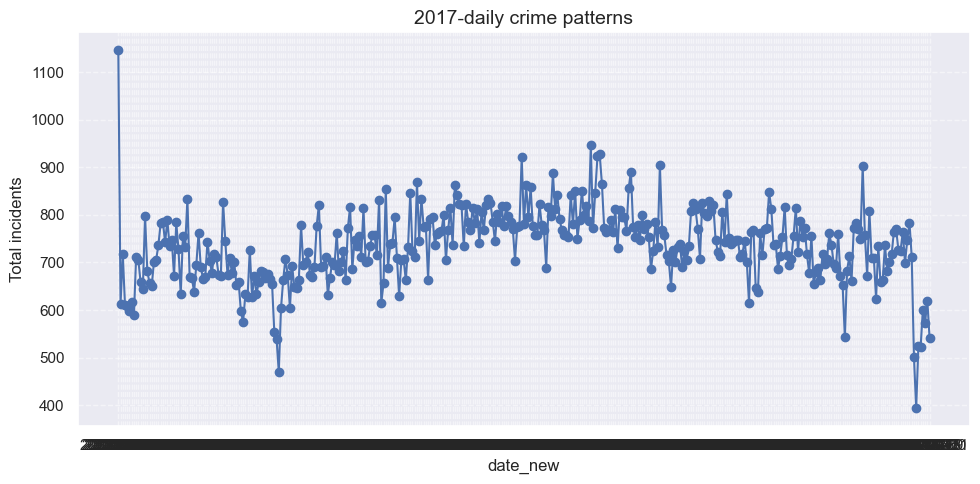

In [61]:
df["date_new"] = df.date_py.dt.date
p_daily = plot_time( df, "date_new", "2017-daily crime patterns")
_ = plt.ylabel("Daily total incidents")

**Answer.**

-------

## Using normalization for fair comparison

Therefore, if we want to compare level of crime across different months, monthly total is probably not a good metric since different months have different numbers of days. To resolve this issue, we will **normalize** the monthly total into some metric that does not depend on the number of days in a month. Normalization of our data is very common and the appropriate method of normalization is generally determined by domain knowledge and the hypothesis generation process which you recently learned in Case 4.3. You want to consistently see how your hypotheses play out in your data by slicing the data in various ways (one being normalizing certain parameters for better comparison).

A natural choice is to divide monthly total by the number of days in a month. The normalized value is indeed the average daily incidents in a month, which can be compared across different months. Let's take a look at the results if we use this normalization. From this, it is clear that March is in fact the least concerning month:

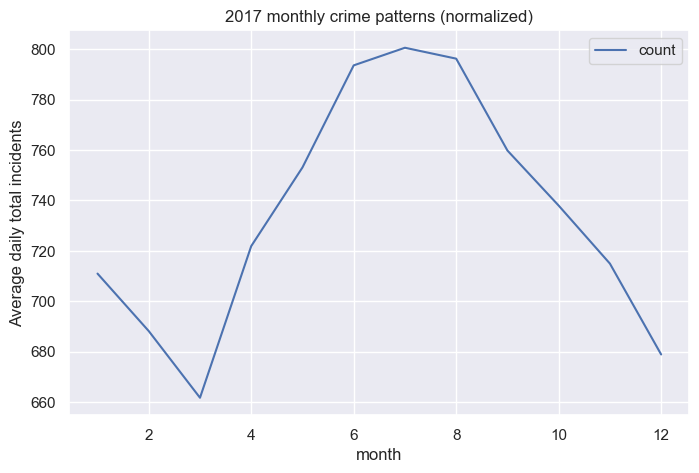

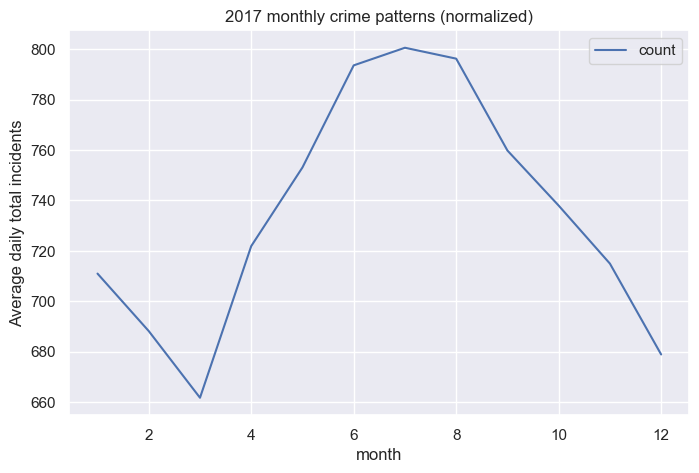

In [70]:
res = df.groupby(["month"])["ID"].count().reset_index(name="count")
res["count"] = res["count"] / [31,28,31,30,31,30,31,31,30,31,30,31]
res.plot(x="month", y="count", title="2017 monthly crime patterns (normalized)")
plt.ylabel("Average daily total incidents")
plt.show()


### Exercise 6:

Choose the correct normalization approach and modify the code above to visualize the crime patterns in every day of a week. Which day in a week has the largest amount of cases?

**Answer.**

In [72]:
df["day"] = df.date_py.dt.day

In [74]:
df.groupby(["day"])["ID"].count().reset_index(name="count")

,day,count
0,1,10577
1,2,8682
2,3,8977
3,4,8893
4,5,8841
5,6,8708
6,7,8376
7,8,8522
8,9,8722
9,10,8594


In [76]:
df["dayofweek"] = df.date_py.dt.dayofweek.astype("category")
df.dayofweek = df.dayofweek.cat.rename_categories(["Mon","Tue","Wed","Thu","Fri","Sat","Sun"])
res = df.groupby(["dayofweek"])['ID'].count().reset_index(name="count")
res['count'] = res['count']/pd.date_range("2017-1-1","2017-12-31",freq="D").dayofweek.value_counts()[::-1]
_ = res.plot(x="dayofweek", y = "count", title = "2017 crime patterns in a week")
_ = plt.ylabel("Average daily total incidents")

C:\Users\mauri\AppData\Local\Temp\ipykernel_5328\4033807947.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  res = df.groupby(["dayofweek"])['ID'].count().reset_index(name="count")


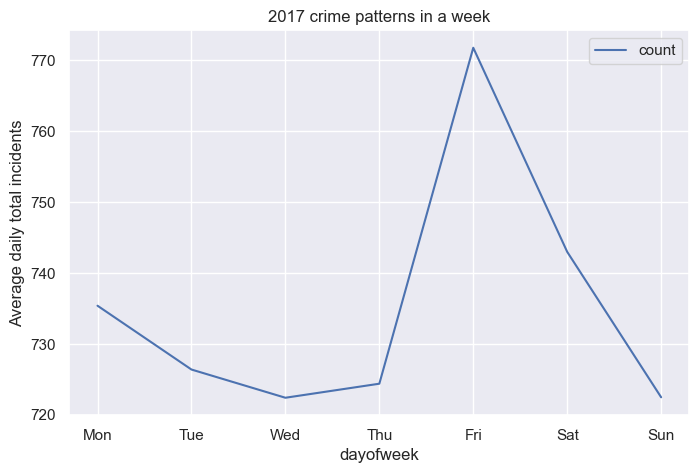

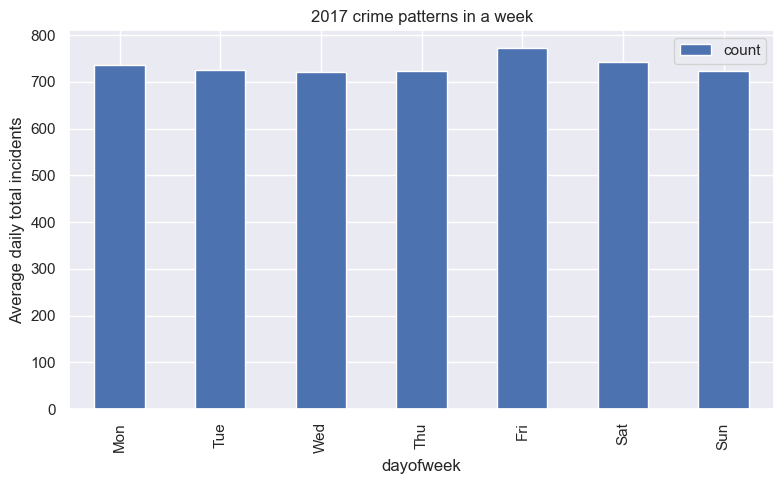

In [78]:
import matplotlib.pyplot as plt

# Crear variable día de la semana como categoría con nombres legibles
df["dayofweek"] = df.date_py.dt.dayofweek.astype("category")
df.dayofweek = df.dayofweek.cat.rename_categories(["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"])

# Agrupar por día de la semana
res = df.groupby(["dayofweek"], observed=False)["ID"].count().reset_index(name="count")

# Normalizar por número de ocurrencias de cada día (por si hay semanas incompletas)
day_counts = pd.date_range("2017-01-01", "2017-12-31", freq="D").dayofweek
normalization = pd.Series(day_counts).value_counts().sort_index()
res["count"] = res["count"] / normalization.values

# Graficar
res.plot(x="dayofweek", y="count", title="2017 crime patterns in a week", kind="bar")
plt.ylabel("Average daily total incidents")
plt.tight_layout()
plt.show()


We find that Friday has significantly higher total incidents compared to all other days of week. The lowest total incidents is reached on Wednesday.

## Investigating crime by geographic location

Another important dimension we need to consider is the relationship between crime incidents and geographic location. The technical aspect of graphing below can be seen as an extension on what we have previously learned about data visualizations. We recommend you slowly review the code in your spare time until you are able to replicate it on a new problem. How we choose to set up these graphs should always be logical and in this case, we are categorizing the data by police beats.

We have the rough geographic coordinate of each incident and based on these, we can explore the geographic patterns of crime in Chicago. To identify geographic hot spots of crimes, we can partition the City of Chicago into non-overlapping regions and count the total number of cases in 2017 in each region. In this case, we divide Chicago by police beats. We then visualize the results on the map:

In [82]:
df["beat_num"] = df["beat_num"].str.zfill(4)
beat_cn = df.groupby("beat_num")["ID"].count().reset_index(name="crime_count")

# color scheme
min_cn, max_cn = beat_cn['crime_count'].quantile([0.01, 0.99]).round(2)

colormap = branca.colormap.LinearColormap(
    colors=['white','yellow','orange','red','darkred'],
    vmin=min_cn,
    vmax=max_cn
)
colormap.caption = "Total crimes in Chicago by police beats"


In [84]:
# load the shape file for Chicago police beats
beat_orig = geopandas.read_file("Boundaries_beat.geojson", driver = "GeoJSON")
beat_data = beat_orig.join(beat_cn.set_index("beat_num"), how = "left", on = "beat_num")
beat_data.fillna(0, inplace = True)

C:\Users\mauri\anaconda3\Lib\site-packages\pyogrio\raw.py:198: RuntimeWarning: driver GeoJSON does not support open option DRIVER
  return ogr_read(


In [86]:
# interactive visualization for beat-specific crime rate in 2017

m_crime = folium.Map(location=[41.88, -87.63],
                        zoom_start=12,
                        tiles="OpenStreetMap")
style_function = lambda x: {
    'fillColor': colormap(x['properties']['crime_count']),
    'color': 'black',
    'weight':2,
    'fillOpacity':0.5
}

stategeo = folium.GeoJson(
    beat_data.to_json(),
    name='Chicago beats',
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(
        fields=['beat_num', 'crime_count'],
        aliases=['Beat', 'Total crime'], 
        localize=True
    )
).add_to(m_crime)

colormap.add_to(m_crime)
m_crime

Overall, we find there are three hot spots in Chicago: Downtown Chicago, West Chicago, and South Chicago. You can hover over each region to see the beat number and the total number of crimes in the beat.

### Exercise 7:



#### 7.1

Based on the analysis so far, what are your preliminary strategies for police deployment based on times, locations and types of crimes? What is the potential business problem you are solving here?

**Answer.**

Based on the results, we have several suggestions: put more police force to work on Fridays, between May and September, and place them in Downtown Chicago as well as the West and South Sides of Chicago. They probably need to focus on streets and residence areas and should pay attention to theft, battery, criminal damage, and assault.

#### 7.2

What is the main shortcoming of our analysis and recommendations in 4.1?

**Answer.**

We see two main pitfalls:

1. The above investigations are for individual patterns associated with each individual variable, and the patterns associated with all these independent variables combined might not be independent. In other words, similar to the previous EDA case, there may exist interaction effects among these variables.

2. We noticed above that most crimes tend to be theft-related. However, most theft offenses are petty, which might not be the type of crime we should focus our limited police force on. More severe crimes, such as homicide cases, are overlooked in the above analyses since they are very rare. But perhaps these rare and severe crimes are the most important offenses to prevent.

The rest of this case study aims to tackle these two shortcomings.

## Investigating joint distributions and interactions

In Exercise 7.2, we cited two potential problems with naively tacking together the patterns we noticed for each individual variable into a recommendation. We tackle the first issue to start: there may exist interaction effects among the variables of interest. Similar to the previous EDA case, we now investigate each potential interaction effect in more detail and challenge our hypotheses.

### Crime type vs. day of the week

Again, we can use a contingency table to answer this question just like we did for `Primary Type` and `Location Description`. One catch here is that you need to normalize the data so that the comparisons are fair across different days of the week:

In [34]:
res_raw = pd.crosstab(df["Primary Type"], df.dayofweek)
res_raw/pd.date_range("2017-1-1","2017-12-31",freq="D").dayofweek.value_counts().tolist()[::-1]

dayofweek,Mon,Tue,Wed,Thu,Fri,Sat,Sun
Primary Type,,,,,,,
ARSON,1.346154,1.173077,1.403846,1.230769,1.115385,1.038462,1.207547
ASSAULT,54.230769,53.942308,55.153846,53.730769,53.403846,49.076923,50.716981
BATTERY,129.884615,125.769231,123.596154,123.519231,129.942308,148.115385,162.547170
BURGLARY,37.076923,36.442308,38.788462,36.019231,41.903846,30.961538,28.264151
CONCEALED CARRY LICENSE VIOLATION,0.192308,0.153846,0.115385,0.230769,0.192308,0.250000,0.188679
CRIM SEXUAL ASSAULT,4.057692,3.634615,4.057692,3.403846,3.923077,5.538462,6.622642
CRIMINAL DAMAGE,80.057692,76.634615,73.423077,74.634615,78.269231,86.480769,87.339623
CRIMINAL TRESPASS,19.423077,18.519231,18.596154,20.000000,19.269231,18.096154,16.830189
DECEPTIVE PRACTICE,57.423077,56.250000,55.865385,56.250000,59.615385,46.673077,36.528302


### Exercise 8:

Your colleague claims that most thefts happen on Mondays, Tuesdays, or Wednesdays. How do you validate or disprove their claim based on the data and the table above? What can you say about the days which have the most battery and assault incidents?

**Answer.**

-------

## Crime time vs. location of the crime

The next potential interaction is between crime time and crime location. The geographic hot spots might shift from time to time and targeting different regions at different times is a natural strategy to increase efficiency. The following map shows how the crime rate varies geographically over time. Here, the outcome of interest is average daily total incidents:

In [92]:
def folium_slider( beat_cn, beat_orig, tmp_drange, index_var, index_lab, 
                   value_var = "crime_count", caption = "Crimes in Chicago" ):
    # get colorbar
    #min_cn, max_cn = beat_cn[value_var].quantile([0.01,0.99]).apply(round, 2)
    min_cn, max_cn = beat_cn[value_var].quantile([0.01, 0.99]).round(2)
    colormap = branca.colormap.LinearColormap(
        colors=['white','yellow','orange','red','darkred'],
        #index=beat_cn['count'].quantile([0.2,0.4,0.6,0.8]),
        vmin=min_cn,
        vmax=max_cn
    )
    colormap.caption=caption
    
    # get styledata for folium
    styledata = {}

    for beat in range(beat_orig.shape[0]):
        res_beat = beat_cn[beat_cn.beat_num==beat_orig.iloc[beat,:].beat_num]
        #fill missing value by zero: no recorded crime that month
        c_count = res_beat.set_index(index_var)[value_var].reindex(tmp_drange).fillna(0)
        df_tmp = pd.DataFrame(
            {'color': [colormap(count) for count in c_count], 'opacity':0.5},
            index = index_lab
        )
        styledata[str(beat)] = df_tmp
    
    styledict = {
        str(beat): data.to_dict(orient='index') for
        beat, data in styledata.items()
    }
    
    # plot map and time slider
    m = folium.Map(location=[41.88, -87.63],
                        zoom_start=12,
                        tiles="OpenStreetMap")

    g = TimeSliderChoropleth(
        beat_orig.to_json(),
        styledict=styledict
    ).add_to(m)

    folium.GeoJson(beat_orig.to_json(), style_function = lambda x: {
        'color': 'black',
        'weight':2,
        'fillOpacity':0
    }, tooltip=folium.GeoJsonTooltip(
            fields=['beat_num'],
            aliases=['Beat'], 
            localize=True
        )).add_to(m)

    colormap.add_to(m)
    
    return m

In [94]:
# cycle in a year
beat_cn_month = df.groupby(["beat_num","month"])["ID"].count().reset_index(name = "crime_count")
nd = pd.DataFrame({"month":range(1,13), "days":[31,28,31,30,31,30,31,31,30,31,30,31]})
beat_cn_month = beat_cn_month.merge(nd, how = "left", on = "month")
beat_cn_month["crime_count"] = beat_cn_month["crime_count"]/beat_cn_month["days"]
folium_slider( beat_cn_month, beat_orig, list(range(1,13)), "month",
               list(pd.date_range( "2017-1", "2017-12", freq = "MS").strftime("%Y-%m")),
               caption = "Average daily total incidents in a month")

### Exercise 9:

From the plot above, what patterns do you observe over time in Downtown Chicago, as well as the West and South Sides of Chicago? Based on this, do we need to refine the strategies we outlined in Exercise 7.1?

**Answer.**

From the map, we can observe that:

Downtown Chicago exhibits moderate levels of crime compared to other regions, with some hotspots but not as intense as in the West and South sides.

The West Side of Chicago displays consistently higher average daily incident rates, particularly in neighborhoods like Austin and North Lawndale, indicating persistent safety concerns.

The South Side, especially areas near Englewood and South Shore, also shows elevated incident rates, with darker red zones suggesting higher criminal activity.

These areas maintain high crime levels over time, which may indicate structural or systemic challenges rather than temporary spikes.

Given these patterns, it is clear that targeted strategies are necessary for the West and South Sides—focusing not only on law enforcement but also on community programs, youth engagement, and economic support. Meanwhile, Downtown may benefit more from preventive measures and real-time monitoring to avoid escalation.

Thus, yes, we should refine our strategies from Exercise 7.1 by focusing resources where the need is consistently greater, and tailoring interventions to the local dynamics of each area.

Vamos a complementar el análisis con una visión temporal por trimestre (quarter) para reforzar los patrones espaciales con evidencia de ciclos de tiempo.

In [97]:
df["quarter"] = df["date_py"].dt.to_period("Q")


In [99]:
beat_q = df.groupby(["beat_num", "quarter"])["ID"].count().reset_index(name="crime_count")


In [101]:
# Crear un dataframe con número de días por trimestre en 2017
days_per_quarter = pd.DataFrame({
    "quarter": pd.period_range("2017Q1", "2017Q4", freq="Q"),
    "days": [90, 91, 92, 92]  # Días por trimestre en 2017
})

# Unir para normalizar
beat_q = beat_q.merge(days_per_quarter, on="quarter")
beat_q["crime_count"] = beat_q["crime_count"] / beat_q["days"]


In [105]:
folium_slider(
    beat_q,
    beat_orig,
    beat_q["quarter"].unique(),
    "quarter",
    [str(q) for q in beat_q["quarter"].unique()],
    caption="Average daily total incidents per quarter"
)


### 🧠 Quarterly Crime Pattern Insights

Based on the interactive quarterly map of average daily total incidents, several patterns emerge:

1. **Downtown Chicago**  
   - Crime levels remain relatively **moderate and stable** over time.
   - While it shows consistent activity, it's not among the highest-risk areas.
   - Preventive and monitoring strategies can help keep this trend stable.

2. **West Side and South Side**  
   - These areas show **persistently high crime levels** across all quarters.
   - Beats in neighborhoods like **Austin, Englewood, and South Shore** display darker tones consistently, indicating **structural issues** that require long-term interventions.
   - This suggests a need for **targeted strategies**, including:
     - Increased patrol presence
     - Community programs
     - Youth engagement
     - Economic opportunity development

3. **Seasonal Patterns**  


-------

### Exercise 10:

Our strategies developed in the previous section suggest that we should pay attention to Fridays as well as the months from May to August. However, is Friday always the most crime-prevalent day of the week regardless of the month we are looking at? Using the code we have developed above, we plot the crime patterns in a week for every month in 2017. Note that normalization is still required here. Based on the results, is our strategy in Exercise 7.1 to focus on Friday valid?

In [127]:
#res_md = df.groupby(['dayofweek','month'])['ID'].count().reset_index(name="count")
res_md = df.groupby(['dayofweek', 'month'], observed=False)['ID'].count().reset_index(name='count')

# normalization
date_2017 = pd.DataFrame( 
    {"dayofweek": pd.date_range("2017-1-1","2017-12-31",freq="D").dayofweek.astype("category"), 
     "month": pd.date_range("2017-1-1","2017-12-31",freq="D").month } )
date_2017["dayofweek"] = date_2017["dayofweek"].cat.rename_categories(["Mon","Tue","Wed","Thu","Fri","Sat","Sun"])
nd_2017 = date_2017.groupby(['month'])['dayofweek'].value_counts().sort_index().reset_index(name="day_count")
res_md_norm = nd_2017.merge( res_md, how = "left", on = ["month","dayofweek"])
res_md_norm['count_norm'] = res_md_norm['count']/res_md_norm['day_count']

res_md_norm['dayofweek'] = res_md_norm['dayofweek'].astype("category").cat.reorder_categories(["Mon","Tue","Wed","Thu","Fri","Sat","Sun"])
res_md_norm['month'] = res_md_norm['month'].astype('category').cat.rename_categories(["Jan","Feb","Mar","Apr","May","Jun","July","Aug","Sep","Oct","Nov","Dec"])
mp = sns.lineplot(data=res_md_norm, x='dayofweek', hue = 'month', y='count_norm', 
                  palette = sns.color_palette("hls",12))
mp = mp.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), ncol=1)
_ = plt.ylabel("Average daily total crimes in a month")
_ = plt.title("Crime patterns across all days in a week in different months")
for i in range(12):
    tmp = res_md_norm[res_md_norm.dayofweek=="Sun"]
    _ = plt.text( 6, tmp['count_norm'].iloc[i], tmp['month'].iloc[i])



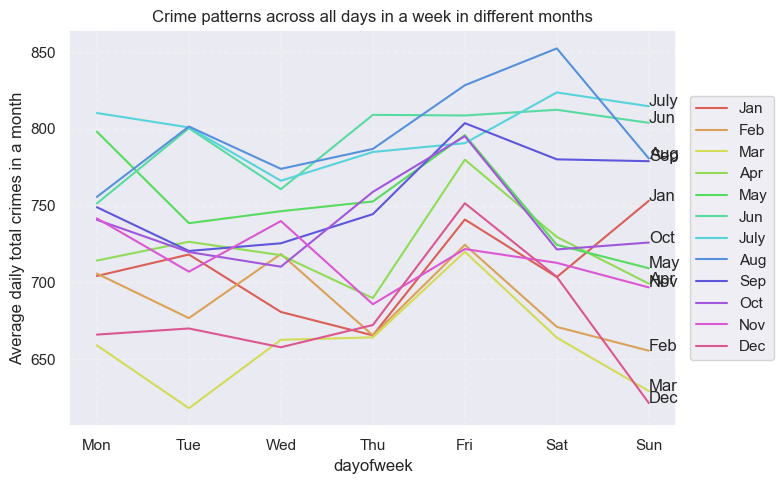

In [131]:
mp = sns.lineplot(data=res_md_norm, x='dayofweek', hue='month', y='count_norm',
                  palette=sns.color_palette("hls", 12))

mp = mp.legend(loc='center left', bbox_to_anchor=(1.01, 0.5), ncol=1)
plt.ylabel("Average daily total crimes in a month")
plt.title("Crime patterns across all days in a week in different months")

for i in range(12):
    tmp = res_md_norm[res_md_norm.dayofweek == "Sun"]
    plt.text(6, tmp['count_norm'].iloc[i], tmp['month'].iloc[i])

plt.tight_layout()
plt.grid(True, linestyle='--', alpha=0.3)

# ✅ LÍNEA CRUCIAL:
plt.show()


**Answer.**

### ✅ Exercise 10 – Analysis of Crime Patterns by Day of Week and Month

The line chart visualizes average daily crime counts across all days of the week, for each month of 2017. The data is normalized to allow fair comparison despite different numbers of weekdays in each month.

#### 🔍 Key Insights:

- **Fridays** are consistently among the days with **higher average incidents**, confirming the hypothesis from Exercise 7.1. However:
  - **July**, **June**, and **August** exhibit **pronounced spikes on Fridays**, showing clear seasonality.
  - **Weekends** (especially **Saturdays**) also present elevated values in these same months.

- In contrast, **Tuesdays and Wednesdays** are generally associated with the **lowest levels of incidents** throughout the year.

- **Winter months** (e.g., **February**, **December**, **March**) show lower values overall, with flatter curves across the week, suggesting less weekly variation during colder periods.

#### 📌 Conclusion:

Focusing strategic deployments on **Fridays** is a valid approach, particularly during warmer months. However, the data supports **expanding focus to Saturdays and seasonal adjustments**. A dynamic, time-aware strategy—tailored by both **day of week** and **month**—is more effective than static rules.



-------

This section has only explored three pairs of potential interactions across all pairs of variables we have. There are of course many other combinations that are important and will lead to further refinement of our deployment plan. We should be able to identify patterns associated with any pair of variables using the tools we developed here. After taking any interactions we find into account, we can then propose an actionable plan.

## Prioritizing by the severity of the crime: IUCR score

So far, we have based our analysis on just the total crime rate. But not all crimes are equally harmful. A homicide case would severely affect a neighborhood even after several years and hinder business development in the area. On the other hand, a case of petty theft is usually not as destructive and would be dismissed after several weeks. 

We can define a different type of outcome which emphasizes crime types that need to be controlled to the minimal level. These crimes are generally determined by municipal development plans of Chicago. For example, if the government aims to promote tourism, crimes targeted at tourists, such as theft and deceptive activities should be the main focus of the police department.

In our dataset, the column `IUCR` is a reporting code that partially measures the damage of an incident to the general well-being of the public. Let's use this code to define a new type of outcome which roughly measures the accumulated damage of all crimes in an area over a period of time. The key idea is that we should focus on places and times that are harmed by crimes the most, not necessarily the ones with the highest total crime incidents.

### Crime severity: IUCR score

``IUCR`` column stands for Illinois Uniform Crime Reporting code, and we can find a full key [here](https://data.cityofchicago.org/Public-Safety/Chicago-Police-Department-Illinois-Uniform-Crime-R/c7ck-438e/data). The most important take-away is that **as code number increases, the severity of associated crimes generally decreases**. 

In [134]:
df['IUCR'].head()

0     630
1     460
2     890
3    1320
4    041A
Name: IUCR, dtype: object

In [136]:
df['IUCR'].values

array(['630', '460', '890', ..., '1330', '486', '1155'], dtype=object)

### Exercise 11:

Some of the IUCR codes have a letter after them (A, P, B, R, C, T, N). An examination of the above link shows that these letters are about convictions, which isn't too relevant to us. Write code to remove the letters and convert this column to a numeric type. Then use function `hist` to visualize the distribution of `IUCR`. Also use function `describe` to summarize `IUCR` (mean, variance, etc). Based on the histogram, do most cases have large IUCR (not severe)?

**Answer.**

In [144]:
# Eliminar cualquier letra al final y convertir a número entero
df["IUCR_PY"] = df["IUCR"].str.extract(r"(\d+)", expand=False).astype(int)

In [154]:
# Extrae solo los números al principio y elimina letras u otros caracteres
df["IUCR_PY"] = df["IUCR"].str.extract(r"^(\d+)", expand=False)

# Luego convierte a tipo numérico (maneja valores nulos con errors='coerce')
df["IUCR_PY"] = pd.to_numeric(df["IUCR_PY"], errors="coerce").astype("Int64")


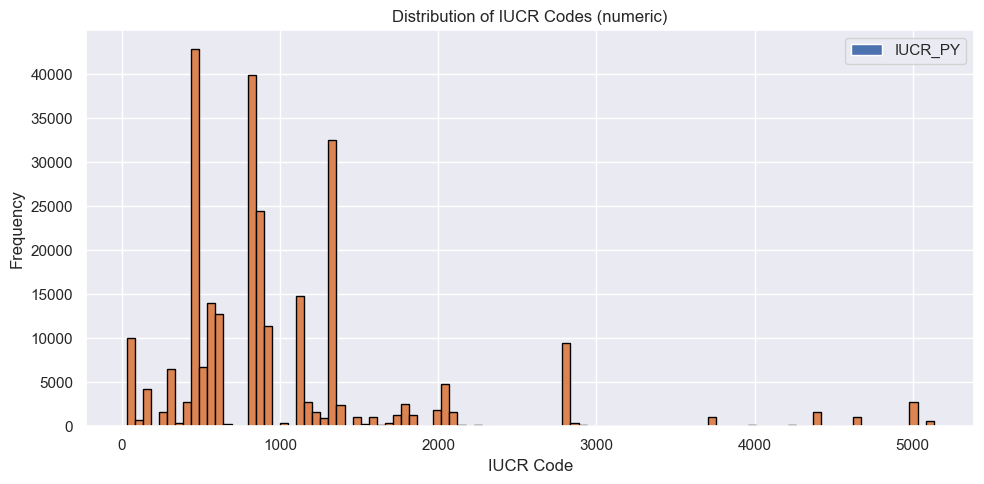

In [158]:
df["IUCR_PY"].plot.hist(bins=100, figsize=(10, 5), grid=True, edgecolor='black')
plt.title("Distribution of IUCR Codes (numeric)")
plt.xlabel("IUCR Code")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()


📊 Histogram:
The histogram reveals a strong concentration of cases at lower IUCR codes, with a steep drop-off after the 1000–1500 range. This suggests that:

Most crimes are associated with lower IUCR values, which likely correspond to more common or less severe offenses.

Higher IUCR codes (above 3000) are much less frequent, and likely represent rarer or more specific classifications.

### Exercise 12:

Given these IUCR scores, how would you integrate them into our crime incidence visualizations so that the final results also represent the severity of crimes in a region?

**Answer.**

Using the scoring scheme we discussed above, let's consider the monthly crime severity across police beats:

In [165]:
# Reescalar IUCR para calcular severidad (entre más alto el código, menos severo)
df["IUCR_num"] = df["IUCR_PY"].max() - df["IUCR_PY"]

# Agrupación mensual por beat
beat_cs_month = df.groupby(["beat_num", "month"]).aggregate({"IUCR_num": "sum"}).reset_index()

# Agregar número de días por mes
nd = pd.DataFrame({"month": range(1, 13), "days": [31,28,31,30,31,30,31,31,30,31,30,31]})

# Unir para normalizar por número de días
beat_cs_month = beat_cs_month.merge(nd, on="month", how="left")

# Calcular severidad promedio diaria
beat_cs_month["severity_tot"] = beat_cs_month["IUCR_num"] / beat_cs_month["days"]

# Visualización en mapa con slider mensual
folium_slider(
    beat_cs_month,
    beat_orig,
    list(range(1, 13)),
    "month",
    list(pd.date_range("2017-1", "2017-12", freq="MS").strftime("%Y-%m")),
    value_var="severity_tot",
    caption="Average daily crime severity in Chicago"
)


It seems that the results here are not significantly different from the results we obtained when we did not incorporate `IUCR`. This might be because most cases have a relatively small raw IUCR and therefore tend to be relatively equally weighted even when we do incorporate `IUCR`.

### Defining a severity score based on the bigger-picture business problem

Since `IUCR` was not particularly useful, let's define a different severity metric. Generally, it is good practice to define a metric that aligns with the bigger-picture goal that the city is trying to achieve. For example, if we want to attract more large companies to open up branches in Chicago, we may care a lot about homicide, sexual assault, and arson, but less about gambling, obscenity, and theft. This type of analysis is rather subjective, but with experience in the field we should gain good intuition about how every type of crime should be bucketed. If we want to be more objective, we could include another dataset of crimes which have been classified by the dollar amount in losses caused by those crimes. We start with a subjective scoring system as an example:

In [167]:
# The zip function creates a list of tuples out of two lists
# The first element of each tuple is the crime type from the first list, and the second element is the severity number

severity_10 = zip(['CRIM_SEXUAL_ASSAULT', 'ARSON', 'HOMICIDE'], [10] * 4)
severity_9 = zip(['BATTERY', 'ASSAULT','ROBBERY', 'BURGLARY'], [9] * 4)
severity_8 = zip(['MOTOR VEHICLE THEFT', 'PUBLIC PEACE VIOLATION',  'CRIMINAL DAMAGE'], [8] * 3)
severity_7 = zip(['CRIMINAL TRESPASS', 'OFFENSE INVOLVING CHILDREN', 'KIDNAPPING'], [7] * 3)
severity_6 = zip(['STALKING', 'PUBLIC INDECENCY'], [6] * 2)
severity_5 = zip(['OTHER OFFENSE', 'HUMAN TRAFFICKING'], [5] * 2)
severity_4 = zip(['DECEPTIVE PRACTICE', 'INTIMIDATION'], [4] * 2)
severity_3 = zip(['INTERFERENCE WITH PUBLIC OFFICER', 'SEX OFFENSE'], [3] * 2)
severity_2 = zip(['NARCOTICS', 'WEAPONS VIOLATION', 'CONCEALED CARRY LICENSE VIOLATION','OBSCENITY'], [2] * 4)
severity_1 = zip(['THEFT','GAMBLING', 'PROSTITUTION', 'LIQUOR LAW VIOLATION', 'NON-CRIMINAL (SUBJECT SPECIFIED)', 'NON-CRIMINAL'], [1] * 5)

# By turning these zipped tuples into a dictionary, we can map each row of the dataset to its severity label
severities = dict()
for s in [severity_1, severity_2, severity_3, severity_4, severity_5, severity_6, severity_7, severity_8, severity_9, severity_10]:
    severities.update(dict(s))

# Our last step is mapping primary_type using this dictionary
df['severity_bus'] = df['Primary Type'].apply(severities.get)

This weighting scheme is suitable for visualizing average per case severity but not for the total severity. The reason is that the range of the weights is rather small (1-10) and crimes with high weights are rare. As a result, the weighted sum given by this weighting scheme is very similar to the unweighted sum and visualizing the weighted sum does not provide additional information. The average per-case severity on the other hand is bounded between 1 and 10. So a small change (e.g. 0.1) in the average can still lead to apparent change in the filling color. Let's take a look at the updated average per case severity score:

In [169]:
# note that we still need to do normalization by days
beat_cs_month = df.groupby(["beat_num","month"]).aggregate({"severity_bus":lambda x: sum(x)}).reset_index()
nd = pd.DataFrame({"month":range(1,13), "days":[31,28,31,30,31,30,31,31,30,31,30,31]})
beat_cs_month = beat_cs_month.merge(nd, how = "left", on = "month")
beat_cs_month["severity_bus_tot"] = beat_cs_month["severity_bus"]/beat_cs_month["days"]
beat_cs_month["severity_bus_avg"] = beat_cs_month["severity_bus_tot"]/beat_cn_month["crime_count"]
folium_slider( beat_cs_month, beat_orig, list(range(1,13)), "month",
              list(pd.date_range( "2017-1", "2017-12", freq = "MS").strftime("%Y-%m")),
              value_var = "severity_bus_avg", caption = "Average crime severity in Chicago")

This map essentially shows the violent parts of Chicago, ignoring theft and putting emphasis on the most violent crimes. Under this prioritization scheme, we see that Downtown Chicago is no longer the worst region; rather, the worst region has now become South Side Chicago. The "safe" North Side is now dotted with some rather violent beats.

## Conclusions

We explored Chicago crime records in 2017 to understand crime patterns and proposed preliminary policy deployment strategies based on these patterns. We initially examined the patterns associated with each variable of interest independently. Based on the single variable analyses, we proposed that the police department should put extra forces to work on Fridays between May and August, pay more attention to theft, battery, assault and criminal damage, and deploy more forces in Downtown Chicago and the West and South Sides of Chicago.

We then conducted analyses for three pairs of variables and found that the above strategies are too rigid and don't take into account interaction effects. We found that Friday is a weekly hot spot outside of summertime, but during summertime, either Saturday becomes the hot spot or no hot spot was present at all. We also found that the time windows of high criminal activities for the three geographic hot spots are not the same: Downtown has a high rate throughout the year, whereas the crimes in the other two regions mostly accumulated between April and August. We found that theft is common in all kinds of locations whereas other types of crimes, such as battery and assault, tend to cluster in a very few number of location types.

In the last part of the analysis, we looked at how to customize weights of different crimes based on the business outcome we were optimizing for. We considered a custom severity score, which highlights the extremely violent cases, and found out that many regions in Chicago have low overall crime incident counts but high violent crime rates. Downtown Chicago, on the other hand, did not harbor violent crimes despite its high overall crime rate. This indicates that if eliminating highly violent crimes is the priority, the previously devised strategies should be changed and there should be more emphasis placed on locations like North Side Chicago.

Moving forward, there are many things we can do. Using this dataset, we can explore other pairwise interaction effects. We can also examine if the strategies we proposed here have already been implemented and whether the deployment plan in use now is successful or not. We can also consider more advanced statistical modeling for our dataset so that all variables can be included, and not just the ones we examined. For those that are interested in this topic, a good starting point is [here](https://en.wikipedia.org/wiki/Spatial_analysis).

## Takeaways

In this case, we learned how to perform exploratory data analysis for records of crime. This type of data does not have as clear of an outcome of interest, so we started by assuming that the outcome of interest is the total number of crime incidents. From there, we followed a similar process as in the last EDA case, except:

1. When investigating variables of interest, we did not use correlation matrices because these make little sense for categorical variables.
2. Instead, we used tools such as frequency tables, word clouds, and contingency tables. We also used maps with a time slider to understand the spatial and temporal patterns.
3. We also learned the importance of normalization to ensure that you are making apples-to-apples comparisons.

Finally, we questioned our original assumption that the number of crime incidents was the most important outcome to optimize for. We also looked at how we ought to weight different crimes differently in our analysis based on the particular business problem at hand.

Case 4.3 was focused on EDA for numerical parameters while Case 4.4 was focused on categorical variables. We simply cannot overemphasize the importance of EDA for any data science problem so we recommend you review both cases rigorously. If you are comfortable with the concepts and technical aspects of both cases, you can find a dataset with a mix of categorical and numerical parameters on a platform like [Kaggle](https://www.kaggle.com/datasets) for further practice. There is no such thing as too much EDA practice.

## Attribution

"Crimes 2017", January 9, 2017, Chicago Data Portal, licensed under the [City of Chicago Terms of Use](https://www.chicago.gov/city/en/narr/foia/data_disclaimer.html), https://data.cityofchicago.org/Public-Safety/Crimes-2017/d62x-nvdr